# Systemy inspekcji wizualnej  
## Laboratorium  5
Temat: Filtracja i wykrywanie krawędzi

Instrukcję opracował: dr inż. Łukasz Jeleń  
  
Wrocław 2022

---

Nazwisko i Imię: Mateusz Śliwiński  
Nr albumu: 253403  
data wykonania ćwiczenia: 21.11.2023  

---

# 1. Narzędzia  
  
  
Na zjęciach korzystamy z pythnona, a jako środowisko pracy mają Państwo do wyboru Google Colab (https://colab.research.google.com) - wersja online, lub Anaconda Navigator (https://www.anaconda.com/) - wymaga instalacji na własnym komputerze. Są to oczywiście tylko propozycje.

# 2. Zadania.
  
## Zadanie 1 - Dodawanie szumu do obrazów.
  

2 dowolnie wybranye obrazy pozyskane w trakcie laboratorium 2 zamień na obrazy monochromatyczne oraz wykonaj poniższe polecenia.

### a) Szum addytywny  
  
Szum addytywny oddziałuje na każdy piksel w obrazie według zależności: $y_{ij}= f_{ij}+ ϵ_{ij}$, gdzie $ϵ_{ij}$ to szum o rzkładzie Gaussa $N(0, σ)$.  
  
Należy dodać szum do wybranych 2 obrazów dla 5 różnych wartości $σ$.

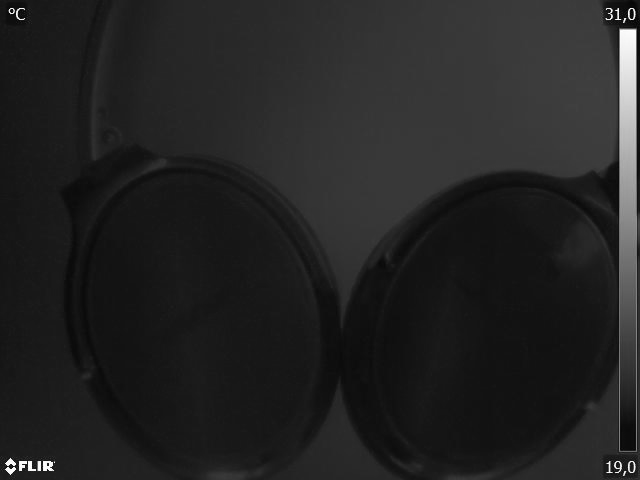

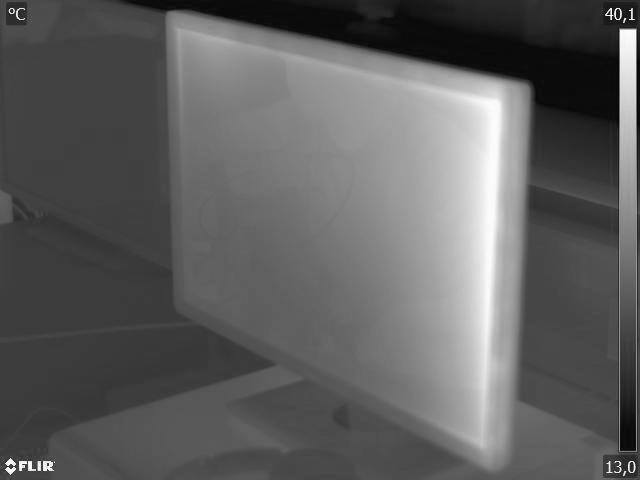

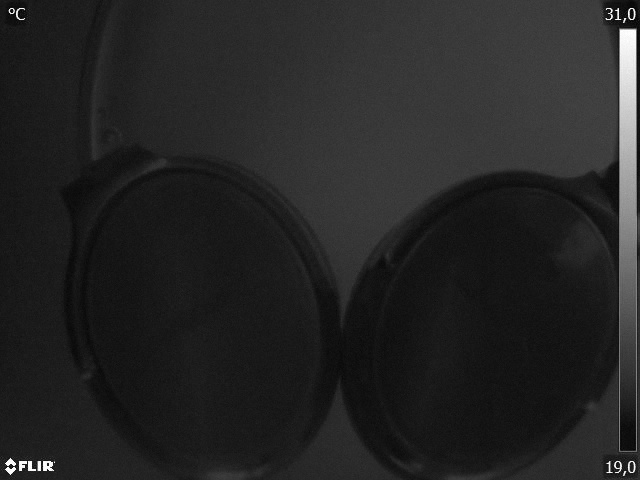

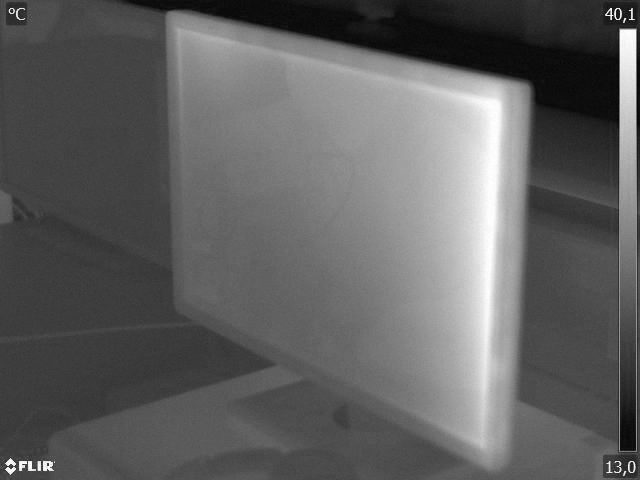

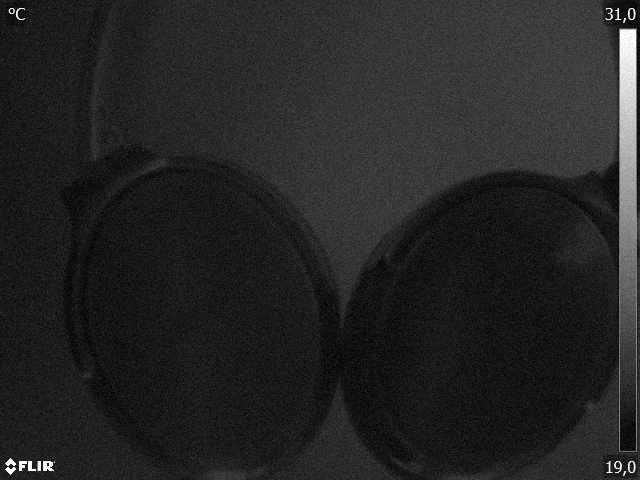

...

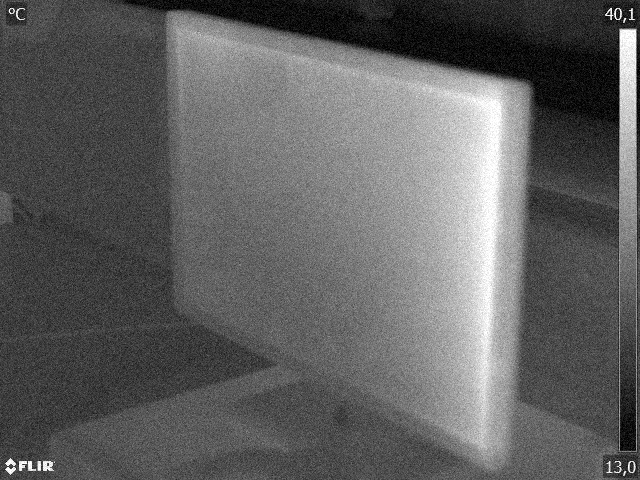

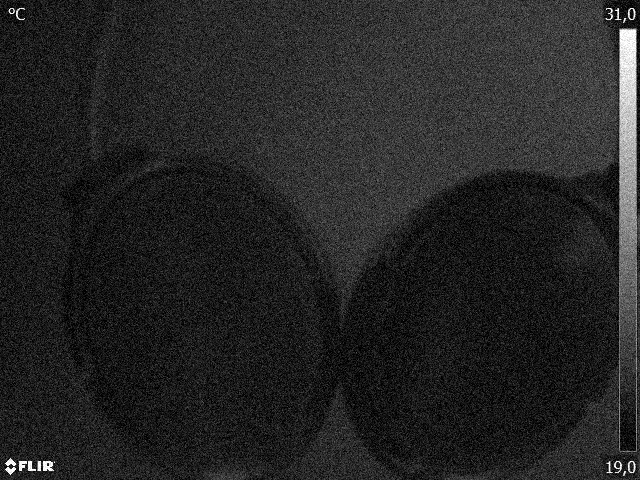

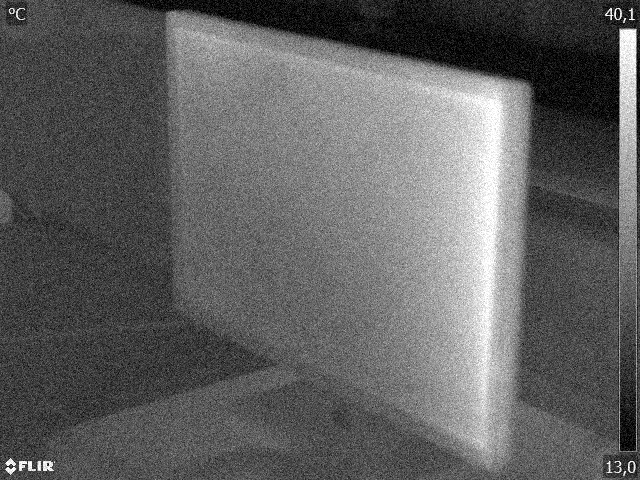

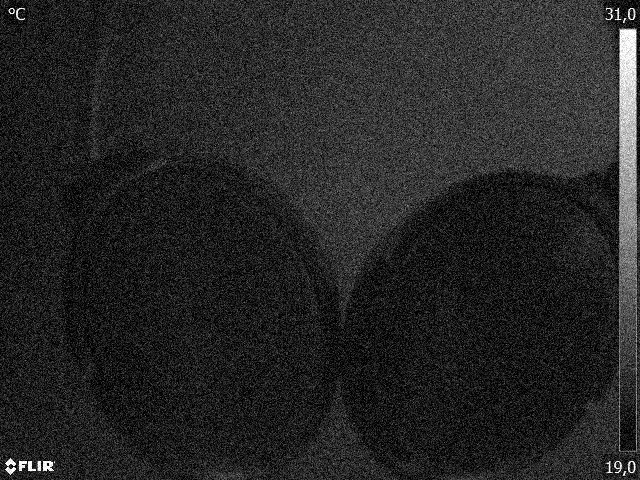

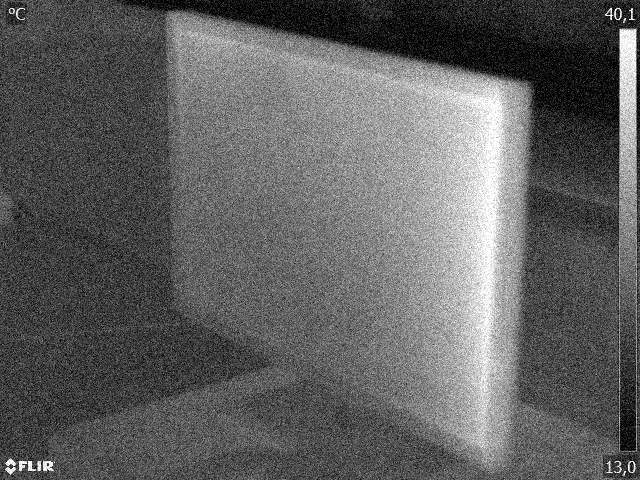

In [103]:
import cv2
import os
import matplotlib.pyplot as plt
import numpy as np
from google.colab.patches import cv2_imshow

img1 = cv2.imread("5.jpg")
img2 = cv2.imread("42.jpg")

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

def gaussian_noise(x,mu,std):
    noise = np.random.normal(mu, std, size = x.shape)
    x_noisy = x + noise
    return x_noisy
mu=2.0
std = 2.0


cv2_imshow(img1)
cv2_imshow(img2)

for x in range(5):
    cv2_imshow(gaussian_noise(img1,mu,std))
    cv2_imshow(gaussian_noise(img2,mu,std))
    cv2.imwrite(f"gauss/{std} Gauss_headphones.jpg", gaussian_noise(img1,mu,std))
    cv2.imwrite(f"gauss/{std} Gauss_Monitor.jpg", gaussian_noise(img2,mu,std))
    std += 5


Opisz swoje spostrzeżenia  
W miarę zwiększania wartości σ wzrasta poziom szumu na obrazie, co prowadzi do coraz bardziej widocznych efektów zakłóceń.

### b) Szum Poissona   
  
  Szum Poissona jest otrzymywany przez zastąpienie wartości oryginalnej $f_{ij}$ przez wartość losową o rozkładzie Poissona.  

Należy dodać szum Poissona do 2 wybranych obrazów sla 5 różnych wartości parametru $λ$.

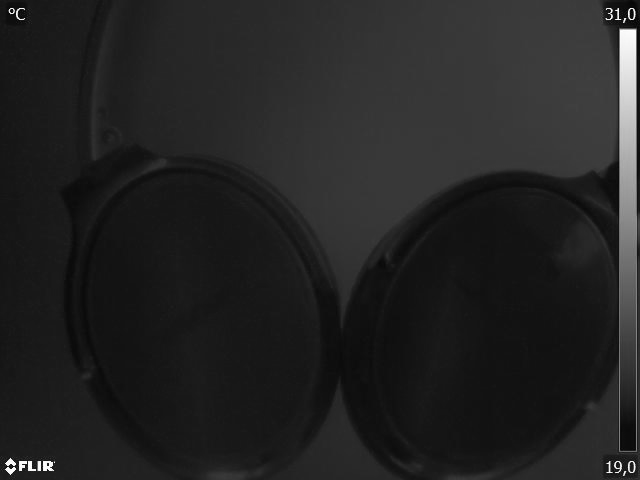

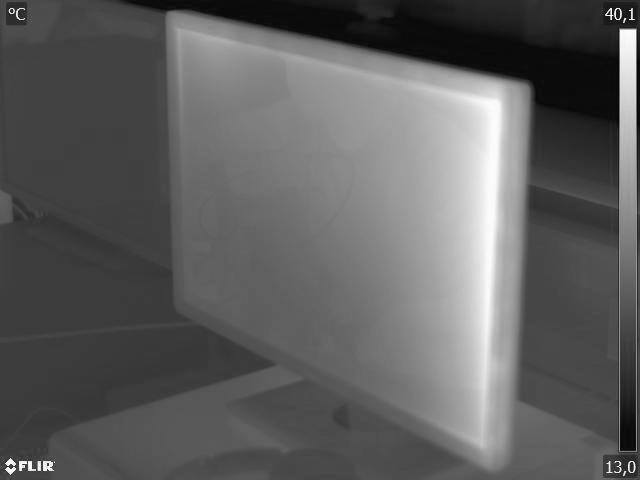

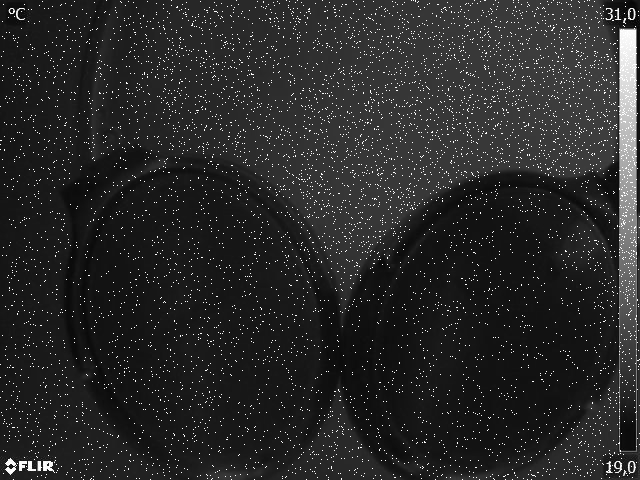

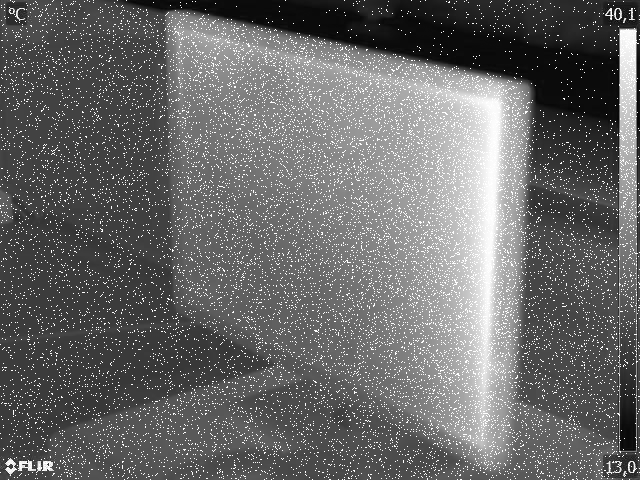

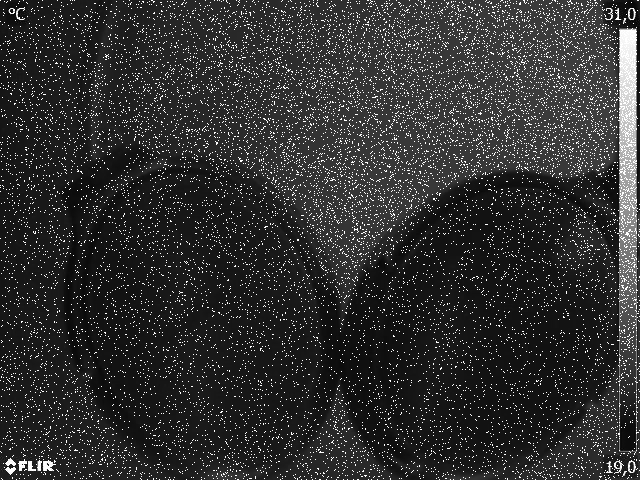

...

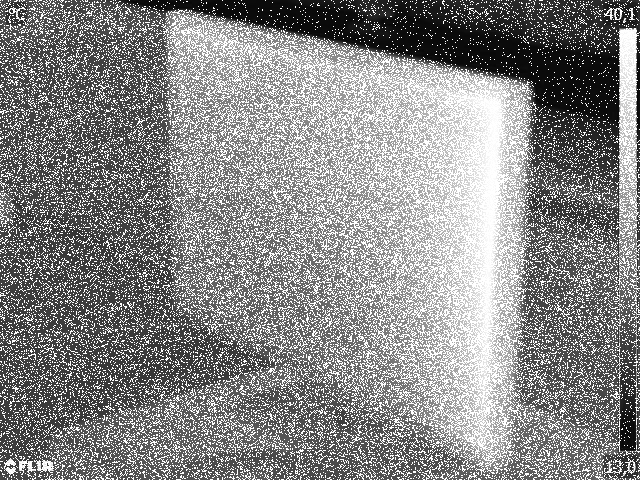

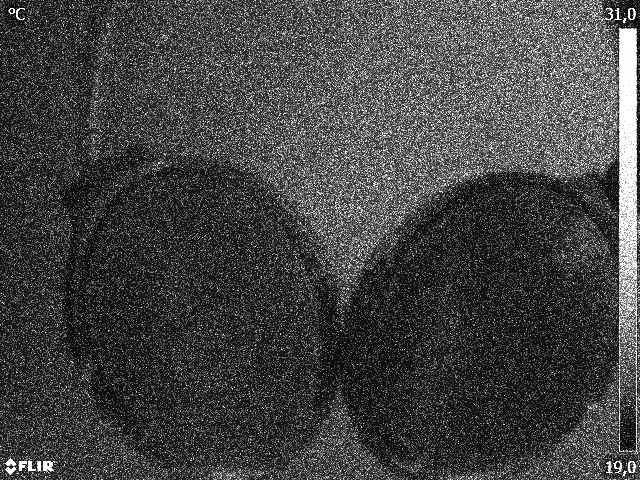

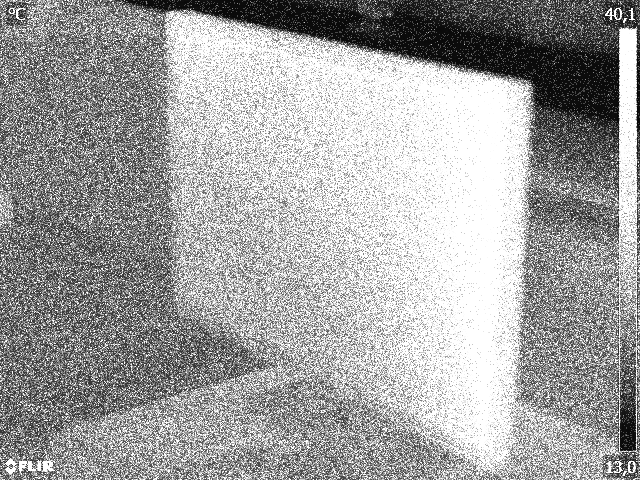

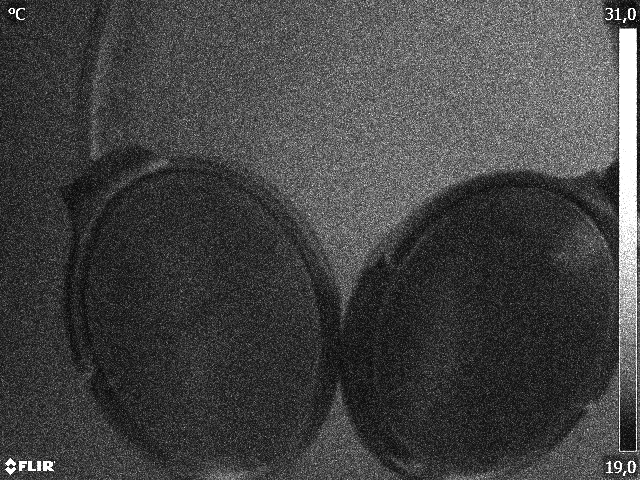

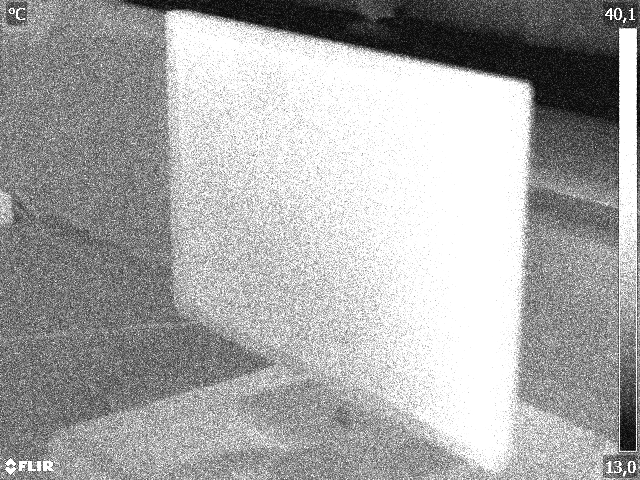

True

In [78]:
def pepper(image,lmbd):
    noisy = np.random.poisson(image / 255.0 * lmbd) / lmbd * 255
    x = image + noisy
    return x

img1 = cv2.imread("5.jpg")
img2 = cv2.imread("42.jpg")

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY).astype(int)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY).astype(int)

cv2_imshow(img1)
cv2_imshow(img2)
lmbd = .2
cv2_imshow(pepper(img1,lmbd))
cv2_imshow(pepper(img2,lmbd))
cv2.imwrite(f"poisson/{lmbd} Poisson_headphones.jpg", pepper(img1,lmbd))
cv2.imwrite(f"poisson/{lmbd} Poisson_Monitor.jpg", pepper(img2,lmbd))
lmbd = .5
cv2_imshow(pepper(img1,lmbd))
cv2_imshow(pepper(img2,lmbd))
cv2.imwrite(f"poisson/{lmbd} Poisson_headphones.jpg", pepper(img1,lmbd))
cv2.imwrite(f"poisson/{lmbd} Poisson_Monitor.jpg", pepper(img2,lmbd))
lmbd = 1
cv2_imshow(pepper(img1,lmbd))
cv2_imshow(pepper(img2,lmbd))
cv2.imwrite(f"poisson/{lmbd} Poisson_headphones.jpg", pepper(img1,lmbd))
cv2.imwrite(f"poisson/{lmbd} Poisson_Monitor.jpg", pepper(img2,lmbd))
lmbd = 4
cv2_imshow(pepper(img1,lmbd))
cv2_imshow(pepper(img2,lmbd))
cv2.imwrite(f"poisson/{lmbd} Poisson_headphones.jpg", pepper(img1,lmbd))
cv2.imwrite(f"poisson/{lmbd} Poisson_Monitor.jpg", pepper(img2,lmbd))
lmbd = 16
cv2_imshow(pepper(img1,lmbd))
cv2_imshow(pepper(img2,lmbd))
cv2.imwrite(f"poisson/{lmbd} Poisson_headphones.jpg", pepper(img1,lmbd))
cv2.imwrite(f"poisson/{lmbd} Poisson_Monitor.jpg", pepper(img2,lmbd))


OPisz swoje spostrzeżenia  
W miarę wzrostu wartości parametru λ, poziom szumu Poissona na obrazie będzie się zwiększał. Im wyższa wartość λ, tym bardziej widoczny będzie efekt szumu.

### c) Szum Salt and Pepper.
  
Szum w którym określona ilość pikselii jest zamieniana według rozkładu jednostajnego i ich wartość $f_{ij}$ jest zamieniana na 0 (czarny) lub biały (255) z prawdopodobieństwem $\frac{1}{2}$.  
  
Należy dodać szum Salt and Pepper do 2 wybranych obrazów dla 5%, 15%, 25%, 35% i 50% pikseli zamienionych na biały i/lub czarny.  


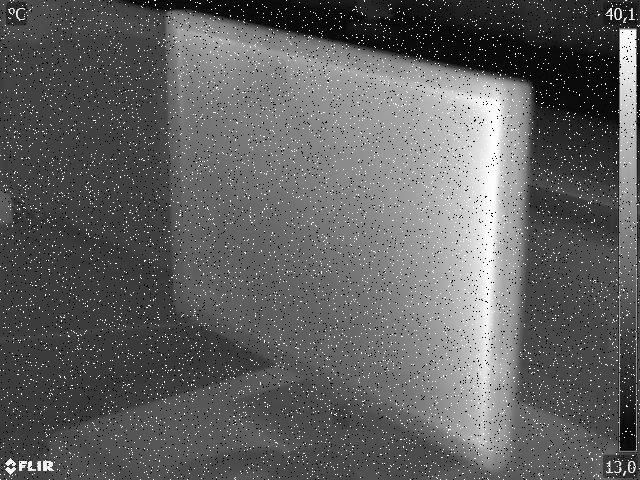

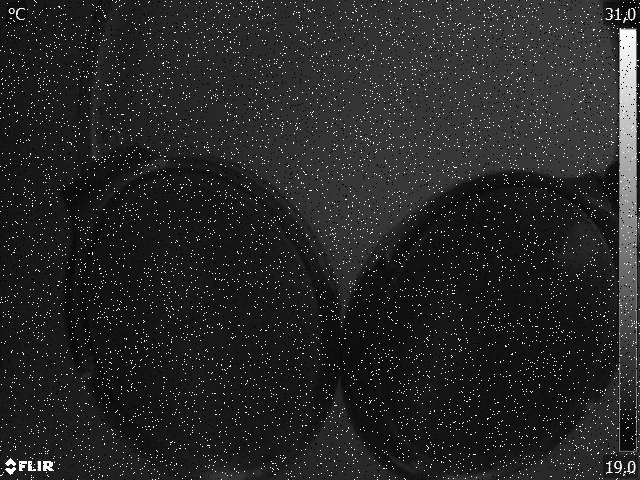

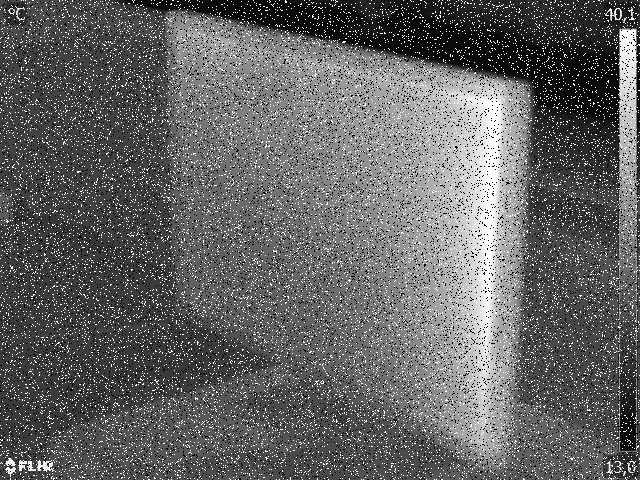

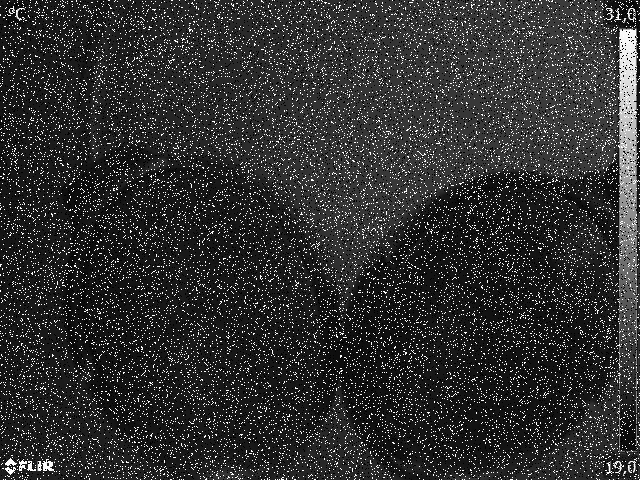

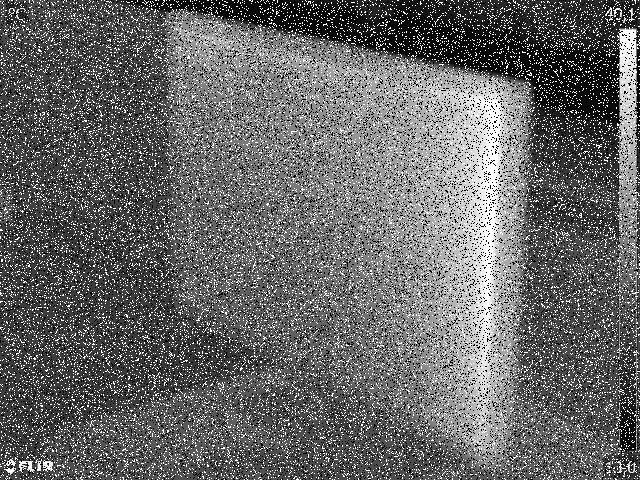

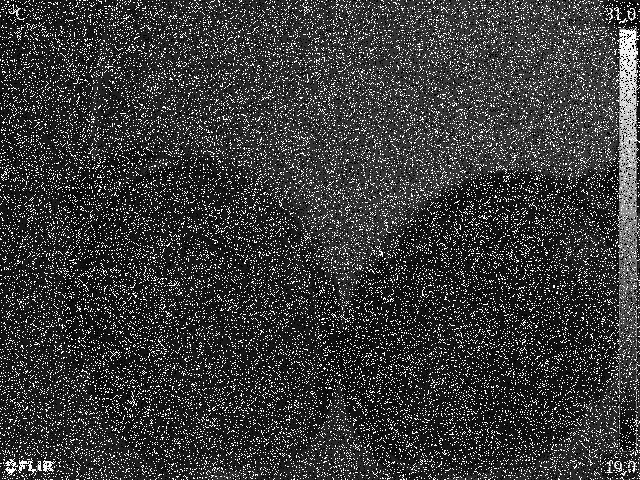

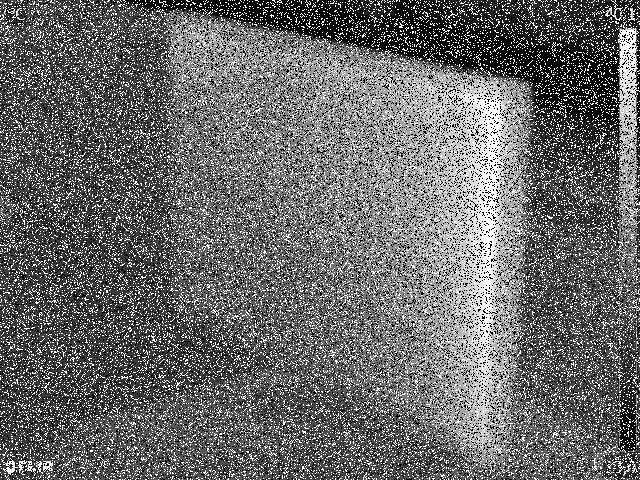

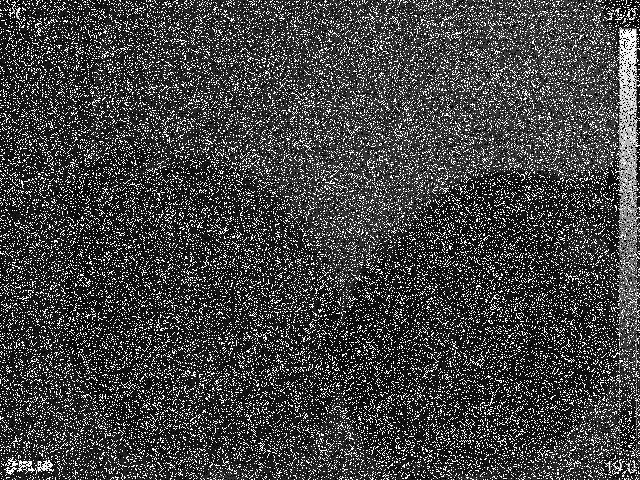

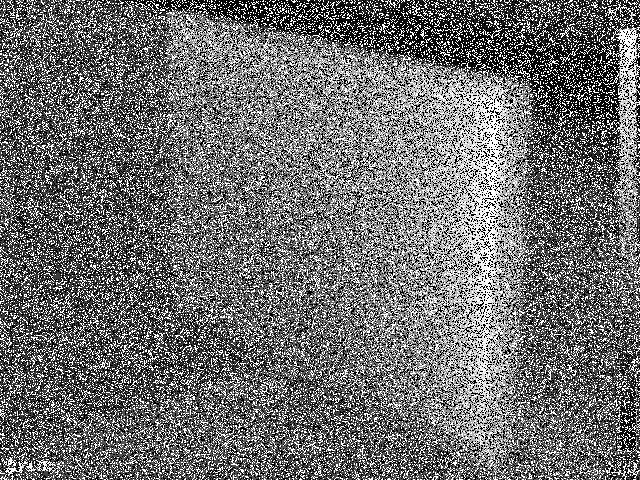

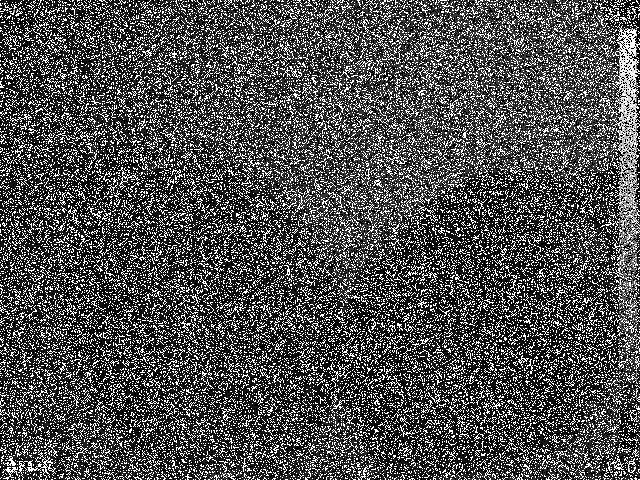

In [79]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def add_salt_and_pepper_noise(image, noise_level):
    row, col = image.shape
    salt_and_pepper = np.random.rand(row, col)

    salt = salt_and_pepper < noise_level / 2.0
    pepper = salt_and_pepper > 1 - noise_level / 2.0

    image[salt] = 255
    image[pepper] = 0

    return image


image1 = cv2.imread("42.jpg", cv2.IMREAD_GRAYSCALE)
image2 = cv2.imread("5.jpg", cv2.IMREAD_GRAYSCALE)

noise_levels = [0.05, 0.15, 0.25, 0.35, 0.5]

for noise_level in noise_levels:
    noisy_image1 = add_salt_and_pepper_noise(image1.copy(), noise_level)
    noisy_image2 = add_salt_and_pepper_noise(image2.copy(), noise_level)
    cv2.imwrite(f"SaP/{noise_level} SaltAndPepper_headphones.jpg", noisy_image1)
    cv2.imwrite(f"SaP/{noise_level} SaltAndPepper_Monitor.jpg", noisy_image2)

    cv2_imshow(noisy_image1)
    cv2_imshow(noisy_image2)

Opisz swoje spostrzeżenia:  
Im wyższy poziom szumu (określający procent pikseli poddanych zamianie), tym bardziej widoczny jest efekt Salt and Pepper na obrazie. Przy niższych poziomach szumu obrazy zachowują większą klarowność, ale przy wyższych może nastąpić utrata szczegółów i jakości.

## Zadanie 2 - Filtrowanie

Dla obrazów otrymanyh w zadaniu 1 oraz obrazu stworzonego na pierwszym laboratorium (obraz z liniami z dodanym szumem) wykonaj poniższe zadania.
  
### a) Filtr Butterworth.
  
Zastosuj filrt Butterworth do wszystkich obrazów

In [111]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def butterworth_filter(image, cutoff_frequency, order):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    rows, cols = image.shape
    crow, ccol = rows // 2 , cols // 2

    mask = np.ones((rows, cols), np.uint8)
    radius = np.sqrt((np.arange(rows)[:,np.newaxis] - crow)**2 + (np.arange(cols)[np.newaxis,:] - ccol)**2)
    mask = 1 / (1 + (radius / cutoff_frequency)**(2*order))

    mask = np.fft.fftshift(mask)

    f_transform = np.fft.fft2(image)
    f_transform_filtered = f_transform * mask
    image_filtered = np.fft.ifft2(f_transform_filtered).real

    return image_filtered

cutoff_frequency = 30
order = 2



In [192]:

import cv2
import os
 def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img = cv2.imread(os.path.join(folder,filename))
        if img is not None:
            images.append(img)
    return images


gauss = []
saltandpepeer = []
poisson = []
image_test = cv2.imread("gauss/12.0 Gauss_Monitor.jpg")
gauss.append(image_test)
image_test = cv2.imread("gauss/12.0 Gauss_headphones.jpg")
gauss.append(image_test)
image_test = cv2.imread("gauss/17.0 Gauss_Monitor.jpg")
gauss.append(image_test)
image_test = cv2.imread("gauss/17.0 Gauss_headphones.jpg")
gauss.append(image_test)
image_test = cv2.imread("gauss/2.0 Gauss_Monitor.jpg")
gauss.append(image_test)
image_test = cv2.imread("gauss/2.0 Gauss_headphones.jpg")
gauss.append(image_test)
image_test = cv2.imread("gauss/22.0 Gauss_Monitor.jpg")
gauss.append(image_test)
image_test = cv2.imread("gauss/22.0 Gauss_headphones.jpg")
gauss.append(image_test)
image_test = cv2.imread("gauss/7.0 Gauss_Monitor.jpg")
gauss.append(image_test)
image_test = cv2.imread("gauss/7.0 Gauss_headphones.jpg")
gauss.append(image_test)


image_test = cv2.imread("SaP/0.05 SaltAndPepper_Monitor.jpg")
saltandpepeer.append(image_test)
image_test = cv2.imread("SaP/0.05 SaltAndPepper_headphones.jpg")
saltandpepeer.append(image_test)
image_test = cv2.imread("SaP/0.15 SaltAndPepper_Monitor.jpg")
saltandpepeer.append(image_test)
image_test = cv2.imread("SaP/0.15 SaltAndPepper_headphones.jpg")
saltandpepeer.append(image_test)
image_test = cv2.imread("SaP/0.25 SaltAndPepper_Monitor.jpg")
saltandpepeer.append(image_test)
image_test = cv2.imread("SaP/0.25 SaltAndPepper_headphones.jpg")
saltandpepeer.append(image_test)
image_test = cv2.imread("SaP/0.35 SaltAndPepper_Monitor.jpg")
saltandpepeer.append(image_test)
image_test = cv2.imread("SaP/0.35 SaltAndPepper_headphones.jpg")
saltandpepeer.append(image_test)
image_test = cv2.imread("SaP/0.5 SaltAndPepper_Monitor.jpg")
saltandpepeer.append(image_test)
image_test = cv2.imread("SaP/0.5 SaltAndPepper_headphones.jpg")
saltandpepeer.append(image_test)


image_test = cv2.imread("poisson/0.2 Poisson_Monitor.jpg")
poisson.append(image_test)
image_test = cv2.imread("poisson/0.2 Poisson_headphones.jpg")
poisson.append(image_test)
image_test = cv2.imread("poisson/0.5 Poisson_Monitor.jpg")
poisson.append(image_test)
image_test = cv2.imread("poisson/0.5 Poisson_headphones.jpg")
poisson.append(image_test)
image_test = cv2.imread("poisson/1 Poisson_Monitor.jpg")
poisson.append(image_test)
image_test = cv2.imread("poisson/1 Poisson_headphones.jpg")
poisson.append(image_test)
image_test = cv2.imread("poisson/16 Poisson_Monitor.jpg")
poisson.append(image_test)
image_test = cv2.imread("poisson/16 Poisson_headphones.jpg")
poisson.append(image_test)
image_test = cv2.imread("poisson/4 Poisson_Monitor.jpg")
poisson.append(image_test)
image_test = cv2.imread("poisson/4 Poisson_headphones.jpg")
poisson.append(image_test)


#gauss = load_images_from_folder("gauss/")
#saltandpepeer = load_images_from_folder("SaP/")
#poisson = load_images_from_folder("poisson/")


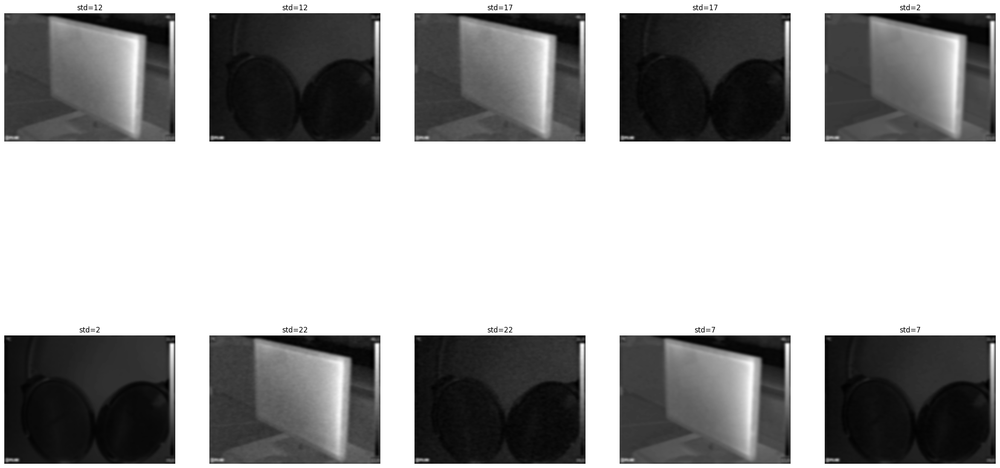

In [191]:

plt.figure(figsize=(30, 18))

plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(butterworth_filter(gauss[0],cutoff_frequency,order),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(butterworth_filter(gauss[1],cutoff_frequency,order),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(butterworth_filter(gauss[2],cutoff_frequency,order),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(butterworth_filter(gauss[3],cutoff_frequency,order),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(butterworth_filter(gauss[4],cutoff_frequency,order),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(butterworth_filter(gauss[5],cutoff_frequency,order),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(butterworth_filter(gauss[6],cutoff_frequency,order),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(butterworth_filter(gauss[7],cutoff_frequency,order),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(butterworth_filter(gauss[8],cutoff_frequency,order),cmap='gray')
plt.title(f'std=7')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(butterworth_filter(gauss[9],cutoff_frequency,order),cmap='gray')
plt.title(f'std=7')


plt.show()

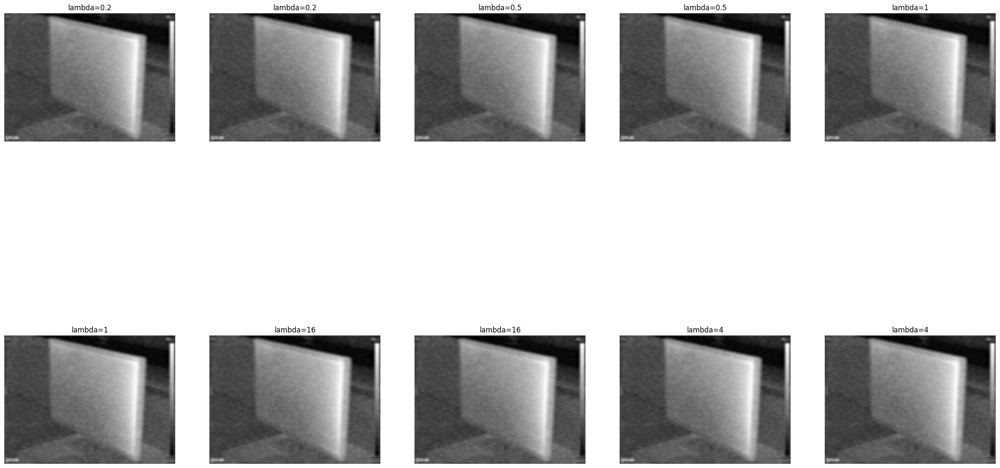

In [193]:
plt.figure(figsize=(30, 18))

plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(butterworth_filter(poisson[0],cutoff_frequency,order),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(butterworth_filter(poisson[0],cutoff_frequency,order),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(butterworth_filter(poisson[0],cutoff_frequency,order),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(butterworth_filter(poisson[0],cutoff_frequency,order),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(butterworth_filter(poisson[0],cutoff_frequency,order),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(butterworth_filter(poisson[0],cutoff_frequency,order),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(butterworth_filter(poisson[0],cutoff_frequency,order),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(butterworth_filter(poisson[0],cutoff_frequency,order),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(butterworth_filter(poisson[0],cutoff_frequency,order),cmap='gray')
plt.title(f'lambda=4')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(butterworth_filter(poisson[0],cutoff_frequency,order),cmap='gray')
plt.title(f'lambda=4')


plt.show()

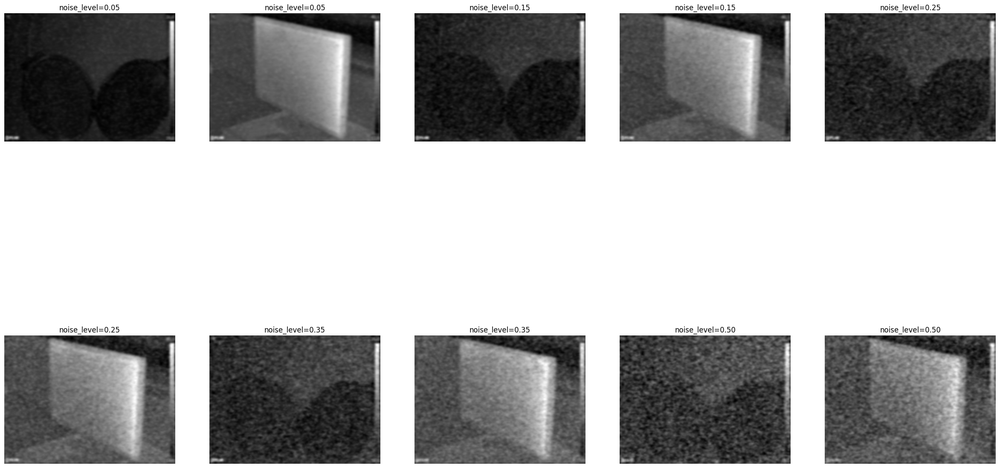

In [194]:
plt.figure(figsize=(30, 18))

plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(butterworth_filter(saltandpepeer[0],cutoff_frequency,order),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(butterworth_filter(saltandpepeer[1],cutoff_frequency,order),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(butterworth_filter(saltandpepeer[2],cutoff_frequency,order),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(butterworth_filter(saltandpepeer[3],cutoff_frequency,order),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(butterworth_filter(saltandpepeer[4],cutoff_frequency,order),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(butterworth_filter(saltandpepeer[5],cutoff_frequency,order),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(butterworth_filter(saltandpepeer[6],cutoff_frequency,order),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(butterworth_filter(saltandpepeer[7],cutoff_frequency,order),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(butterworth_filter(saltandpepeer[8],cutoff_frequency,order),cmap='gray')
plt.title(f'noise_level=0.50')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(butterworth_filter(saltandpepeer[9],cutoff_frequency,order),cmap='gray')
plt.title(f'noise_level=0.50')


plt.show()

Opisz swoje spostrzeżenia
Filtr butterwortha zmniejszył poziom szumu. Najlepiej poradził sobie z małymi poziomami szumu. Przy dużych poziomach szumu dla obrazu ze słuchawki nie da się ich rozpoznać.

### b) Filtr Gaussowski.
  
Zastosuj filrt Gaussowski do wszystkich obrazów dla 3 różnych warotści $σ$

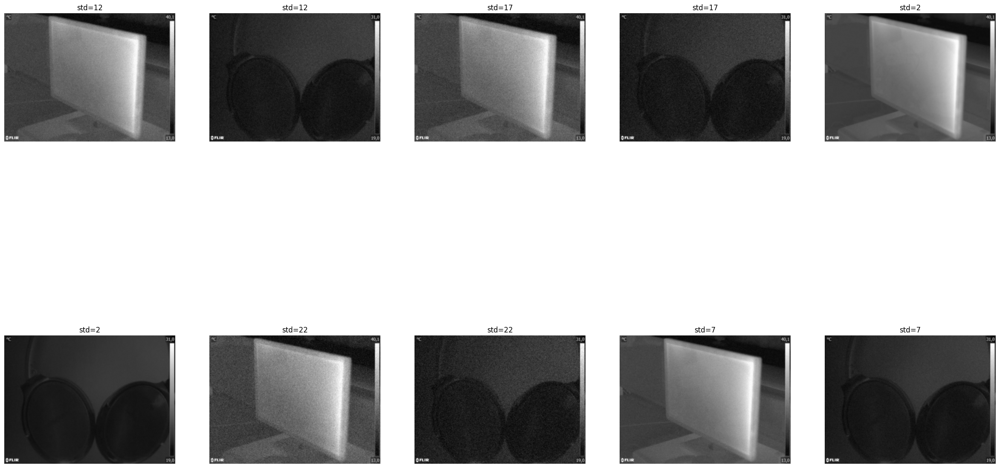

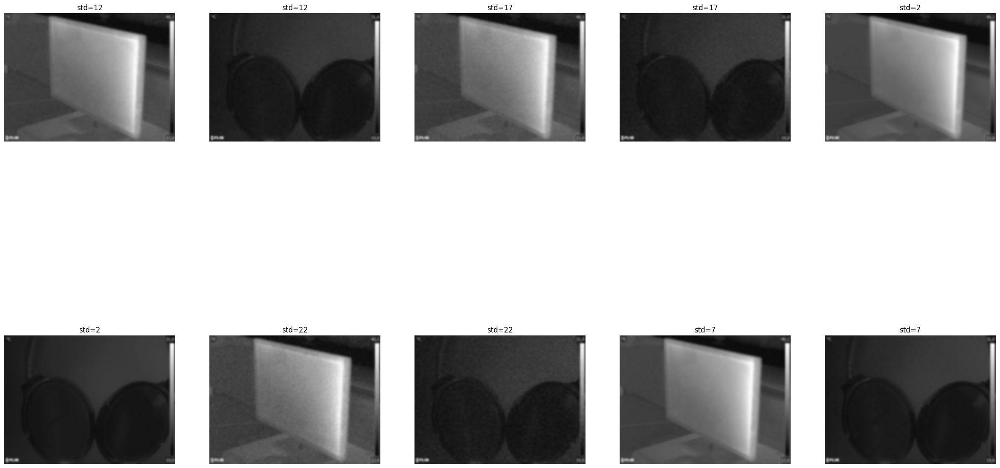

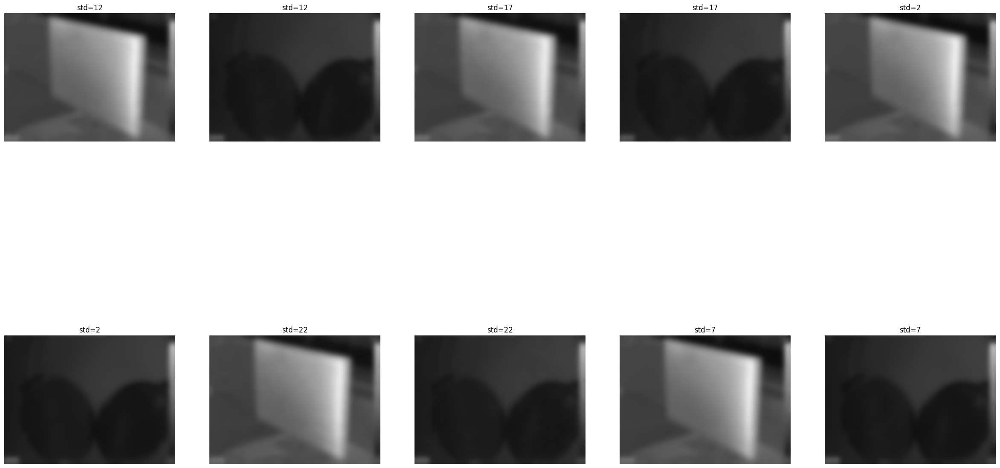

In [195]:


plt.figure(figsize=(30, 18))
sigma = 1
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[0],sigma),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[1],sigma),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[2],sigma),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[3],sigma),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[4],sigma),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[5],sigma),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[6],sigma),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[7],sigma),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[8],sigma),cmap='gray')
plt.title(f'std=7')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[9],sigma),cmap='gray')
plt.title(f'std=7')


plt.show()

plt.figure(figsize=(30, 18))
sigma = 3
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[0],sigma),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[1],sigma),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[2],sigma),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[3],sigma),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[4],sigma),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[5],sigma),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[6],sigma),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[7],sigma),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[8],sigma),cmap='gray')
plt.title(f'std=7')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[9],sigma),cmap='gray')
plt.title(f'std=7')


plt.show()

plt.figure(figsize=(30, 18))
sigma = 10
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[0],sigma),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[1],sigma),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[2],sigma),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[3],sigma),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[4],sigma),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[5],sigma),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[6],sigma),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[7],sigma),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[8],sigma),cmap='gray')
plt.title(f'std=7')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(gaussian_filter(gauss[9],sigma),cmap='gray')
plt.title(f'std=7')


plt.show()

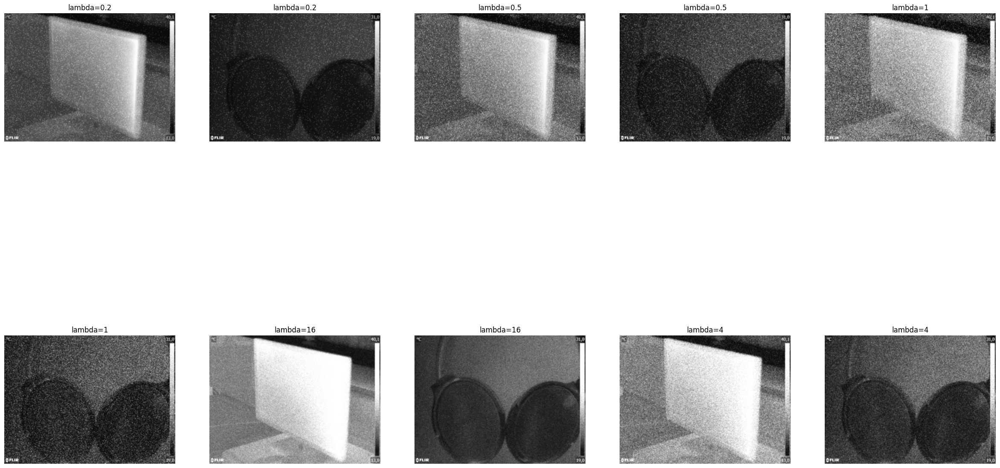

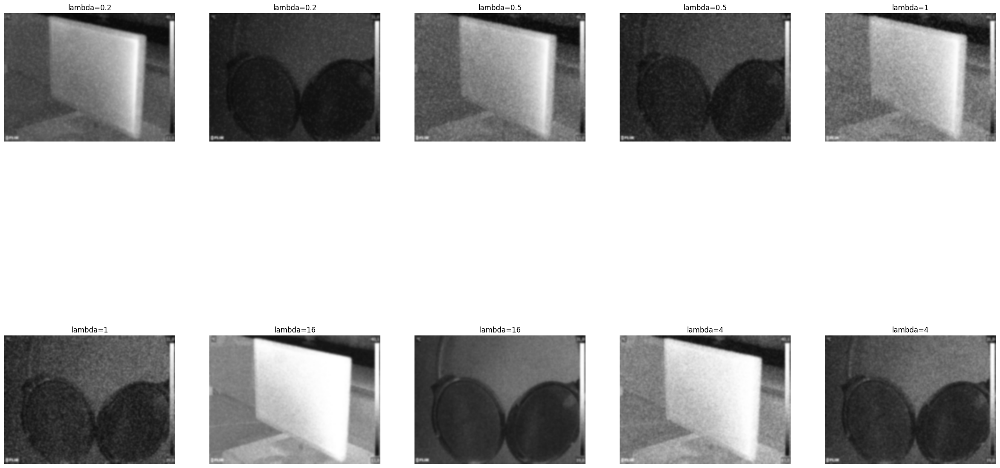

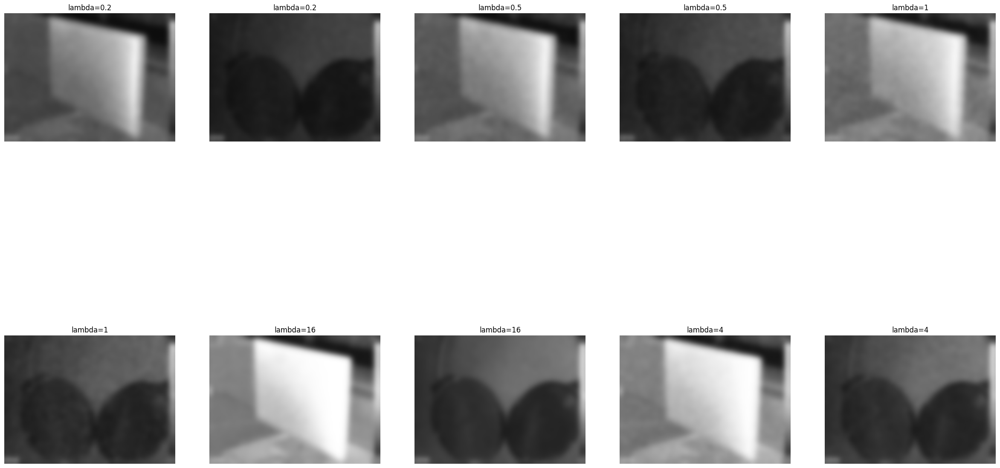

In [196]:
sigma = 1
plt.figure(figsize=(30, 18))
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[0],sigma),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[1],sigma),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[2],sigma),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[3],sigma),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[4],sigma),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[5],sigma),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[6],sigma),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[7],sigma),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[8],sigma),cmap='gray')
plt.title(f'lambda=4')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[9],sigma),cmap='gray')
plt.title(f'lambda=4')


plt.show()
sigma = 3
plt.figure(figsize=(30, 18))
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[0],sigma),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[1],sigma),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[2],sigma),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[3],sigma),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[4],sigma),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[5],sigma),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[6],sigma),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[7],sigma),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[8],sigma),cmap='gray')
plt.title(f'lambda=4')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[9],sigma),cmap='gray')
plt.title(f'lambda=4')


plt.show()
sigma = 10
plt.figure(figsize=(30, 18))
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[0],sigma),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[1],sigma),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[2],sigma),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[3],sigma),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[4],sigma),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[5],sigma),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[6],sigma),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[7],sigma),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[8],sigma),cmap='gray')
plt.title(f'lambda=4')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(gaussian_filter(poisson[9],sigma),cmap='gray')
plt.title(f'lambda=4')


plt.show()

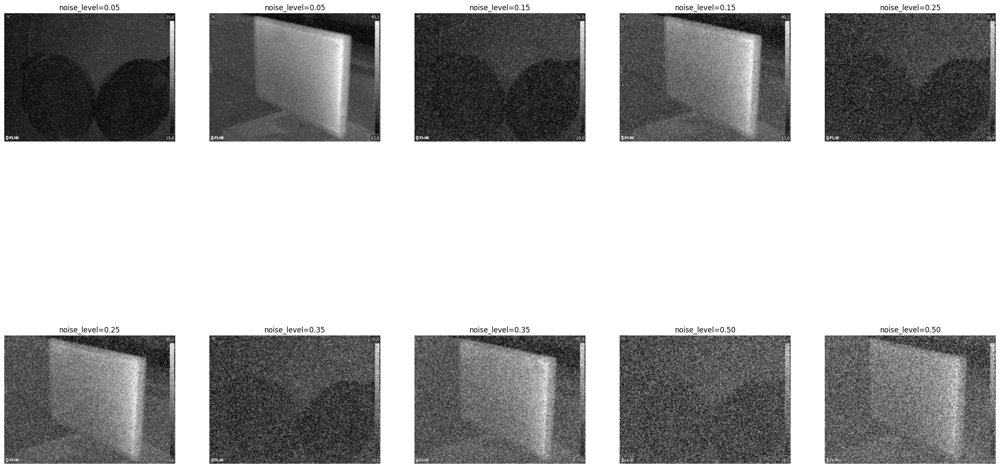

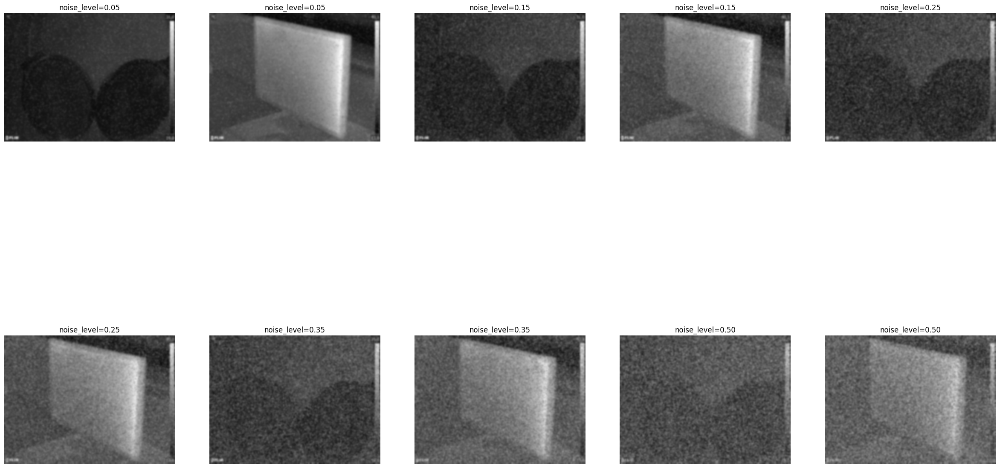

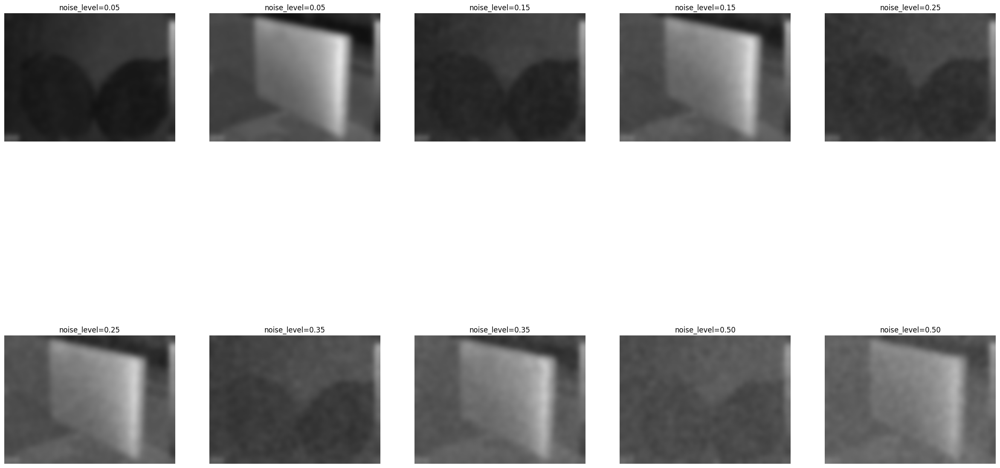

In [197]:
plt.figure(figsize=(30, 18))
sigma = 1
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[0],sigma),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[1],sigma),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[2],sigma),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[3],sigma),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[4],sigma),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[5],sigma),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[6],sigma),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[7],sigma),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[8],sigma),cmap='gray')
plt.title(f'noise_level=0.50')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[9],sigma),cmap='gray')
plt.title(f'noise_level=0.50')


plt.show()
plt.figure(figsize=(30, 18))
sigma = 3
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[0],sigma),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[1],sigma),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[2],sigma),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[3],sigma),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[4],sigma),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[5],sigma),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[6],sigma),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[7],sigma),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[8],sigma),cmap='gray')
plt.title(f'noise_level=0.50')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[9],sigma),cmap='gray')
plt.title(f'noise_level=0.50')


plt.show()
plt.figure(figsize=(30, 18))
sigma = 10
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[0],sigma),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[1],sigma),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[2],sigma),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[3],sigma),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[4],sigma),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[5],sigma),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[6],sigma),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[7],sigma),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[8],sigma),cmap='gray')
plt.title(f'noise_level=0.50')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(gaussian_filter(saltandpepeer[9],sigma),cmap='gray')
plt.title(f'noise_level=0.50')


plt.show()

Filtr guassowski o wielem lepiej poradził sobie z szumami. W porównaniu do poprzedniego filtra bardzo rozmył wszystkie z obrazów.

### c) Filtr Medianowy.
  
Zastosuj filrt Medianowy do wszystkich obrazów dla 3 wartości okna (5x5, 11x11, 21x21)

In [148]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def median_filter(image, kernel_size):
    return cv2.medianBlur(image, kernel_size)



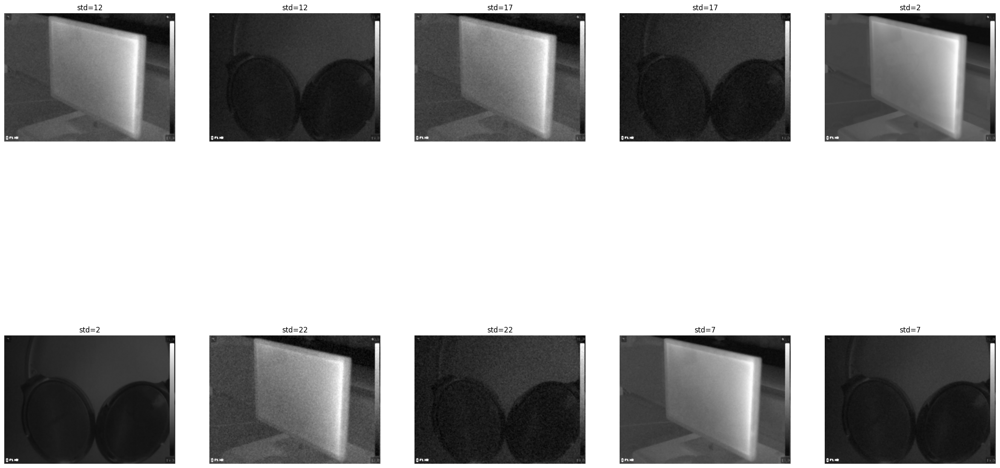

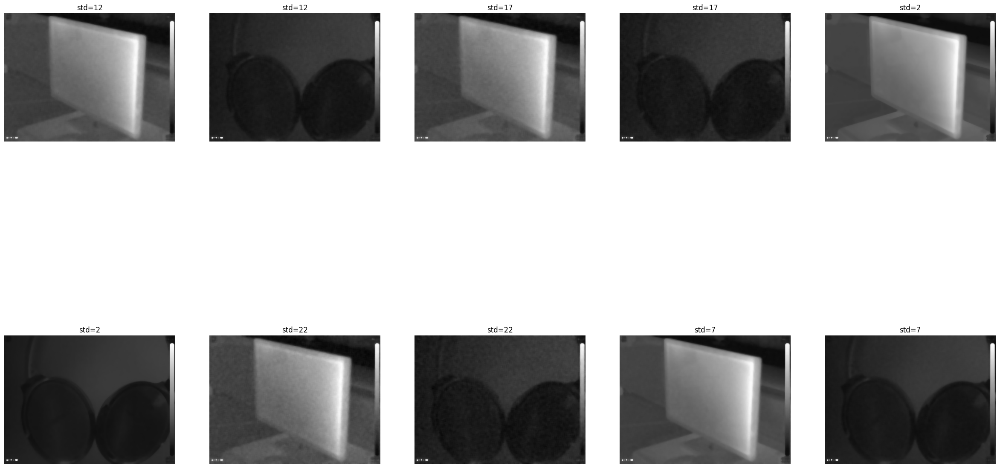

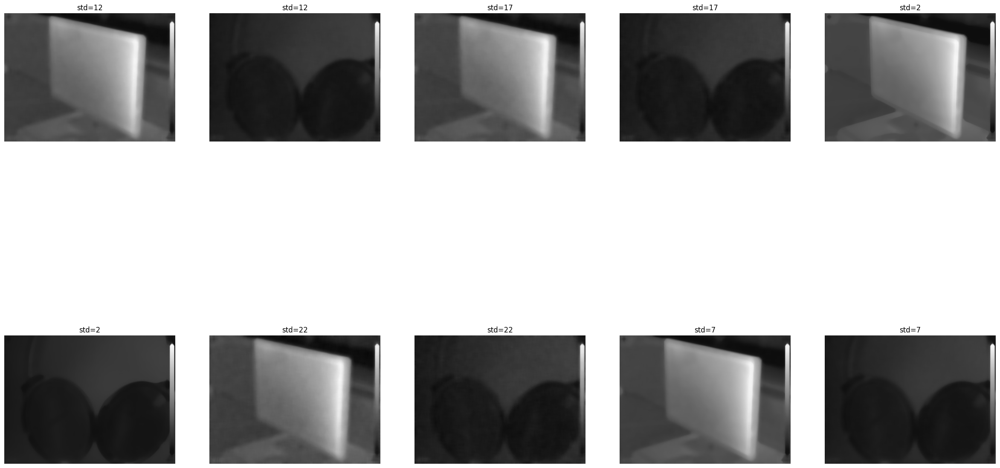

In [198]:
plt.figure(figsize=(30, 18))
sigma = 10
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(median_filter(gauss[0],kernel_sizes[0]),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(median_filter(gauss[1],kernel_sizes[0]),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(median_filter(gauss[2],kernel_sizes[0]),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(median_filter(gauss[3],kernel_sizes[0]),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(median_filter(gauss[4],kernel_sizes[0]),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(median_filter(gauss[5],kernel_sizes[0]),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(median_filter(gauss[6],kernel_sizes[0]),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(median_filter(gauss[7],kernel_sizes[0]),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(median_filter(gauss[8],kernel_sizes[0]),cmap='gray')
plt.title(f'std=7')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(median_filter(gauss[9],kernel_sizes[0]),cmap='gray')
plt.title(f'std=7')


plt.show()

plt.figure(figsize=(30, 18))
sigma = 10
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(median_filter(gauss[0],kernel_sizes[1]),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(median_filter(gauss[1],kernel_sizes[1]),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(median_filter(gauss[2],kernel_sizes[1]),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(median_filter(gauss[3],kernel_sizes[1]),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(median_filter(gauss[4],kernel_sizes[1]),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(median_filter(gauss[5],kernel_sizes[1]),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(median_filter(gauss[6],kernel_sizes[1]),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(median_filter(gauss[7],kernel_sizes[1]),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(median_filter(gauss[8],kernel_sizes[1]),cmap='gray')
plt.title(f'std=7')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(median_filter(gauss[9],kernel_sizes[1]),cmap='gray')
plt.title(f'std=7')


plt.show()
plt.figure(figsize=(30, 18))
sigma = 10
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(median_filter(gauss[0],kernel_sizes[2]),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(median_filter(gauss[1],kernel_sizes[2]),cmap='gray')
plt.title(f'std=12')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(median_filter(gauss[2],kernel_sizes[2]),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(median_filter(gauss[3],kernel_sizes[2]),cmap='gray')
plt.title(f'std=17')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(median_filter(gauss[4],kernel_sizes[2]),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(median_filter(gauss[5],kernel_sizes[2]),cmap='gray')
plt.title(f'std=2')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(median_filter(gauss[6],kernel_sizes[2]),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(median_filter(gauss[7],kernel_sizes[2]),cmap='gray')
plt.title(f'std=22')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(median_filter(gauss[8],kernel_sizes[2]),cmap='gray')
plt.title(f'std=7')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(median_filter(gauss[9],kernel_sizes[2]),cmap='gray')
plt.title(f'std=7')


plt.show()

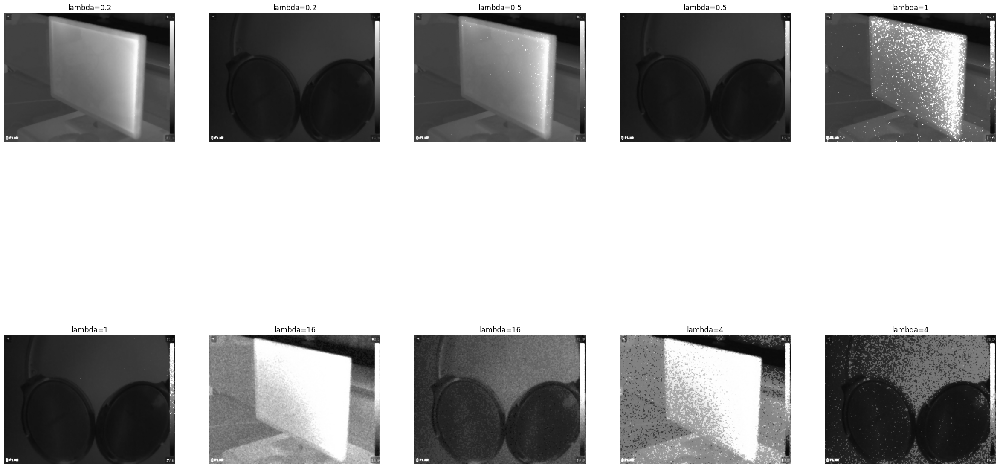

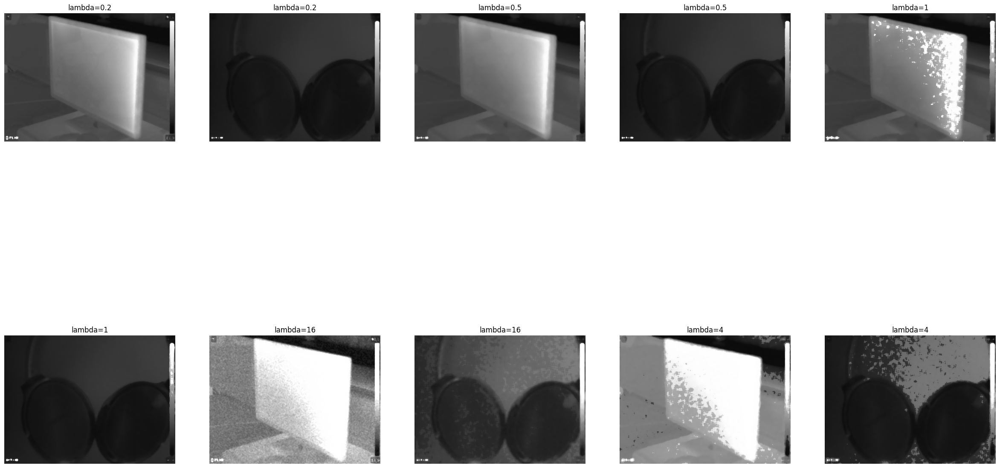

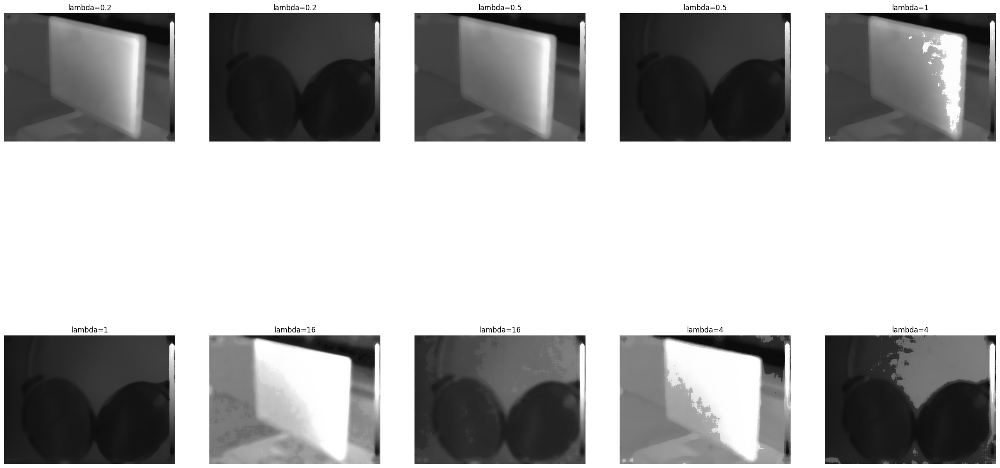

In [199]:
plt.show()
plt.figure(figsize=(30, 18))
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(median_filter(poisson[0],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(median_filter(poisson[1],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(median_filter(poisson[2],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(median_filter(poisson[3],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(median_filter(poisson[4],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(median_filter(poisson[5],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(median_filter(poisson[6],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(median_filter(poisson[7],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(median_filter(poisson[8],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=4')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(median_filter(poisson[9],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=4')


plt.show()
plt.show()
plt.figure(figsize=(30, 18))
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(median_filter(poisson[0],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(median_filter(poisson[1],kernel_sizes[1]),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(median_filter(poisson[2],kernel_sizes[1]),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(median_filter(poisson[3],kernel_sizes[1]),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(median_filter(poisson[4],kernel_sizes[1]),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(median_filter(poisson[5],kernel_sizes[1]),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(median_filter(poisson[6],kernel_sizes[0]),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(median_filter(poisson[7],kernel_sizes[1]),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(median_filter(poisson[8],kernel_sizes[1]),cmap='gray')
plt.title(f'lambda=4')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(median_filter(poisson[9],kernel_sizes[1]),cmap='gray')
plt.title(f'lambda=4')


plt.show()
plt.show()
plt.figure(figsize=(30, 18))
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(median_filter(poisson[0],kernel_sizes[2]),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(median_filter(poisson[1],kernel_sizes[2]),cmap='gray')
plt.title(f'lambda=0.2')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(median_filter(poisson[2],kernel_sizes[2]),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(median_filter(poisson[3],kernel_sizes[2]),cmap='gray')
plt.title(f'lambda=0.5')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(median_filter(poisson[4],kernel_sizes[2]),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(median_filter(poisson[5],kernel_sizes[2]),cmap='gray')
plt.title(f'lambda=1')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(median_filter(poisson[6],kernel_sizes[2]),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(median_filter(poisson[7],kernel_sizes[2]),cmap='gray')
plt.title(f'lambda=16')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(median_filter(poisson[8],kernel_sizes[2]),cmap='gray')
plt.title(f'lambda=4')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(median_filter(poisson[9],kernel_sizes[2]),cmap='gray')
plt.title(f'lambda=4')


plt.show()

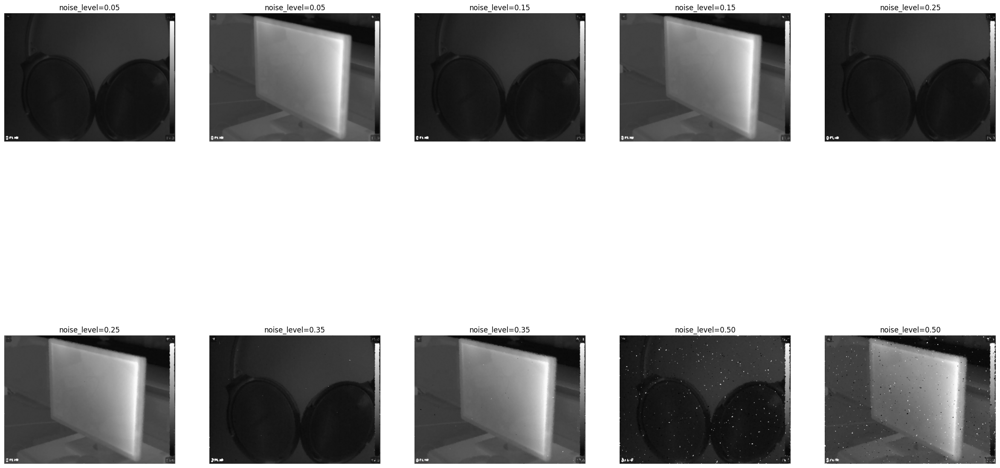

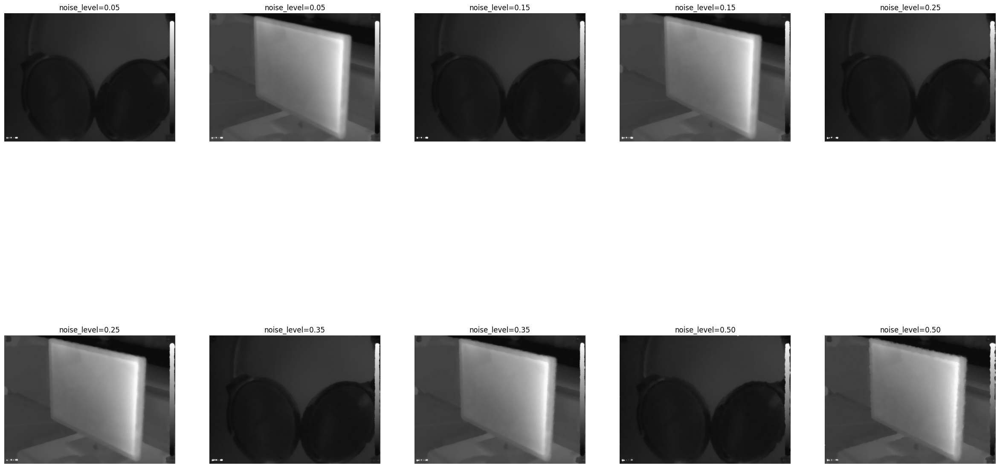

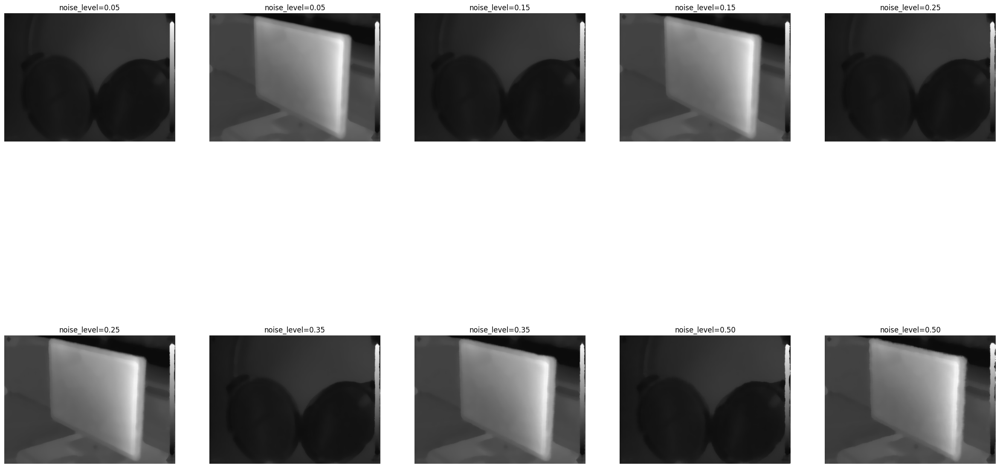

In [200]:

plt.figure(figsize=(30, 18))
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[0],kernel_sizes[0]),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[1],kernel_sizes[0]),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[2],kernel_sizes[0]),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[3],kernel_sizes[0]),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[4],kernel_sizes[0]),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[5],kernel_sizes[0]),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[6],kernel_sizes[0]),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[7],kernel_sizes[0]),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[8],kernel_sizes[0]),cmap='gray')
plt.title(f'noise_level=0.50')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[9],kernel_sizes[0]),cmap='gray')
plt.title(f'noise_level=0.50')


plt.show()
plt.figure(figsize=(30, 18))
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[0],kernel_sizes[1]),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[1],kernel_sizes[1]),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[2],kernel_sizes[1]),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[3],kernel_sizes[1]),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[4],kernel_sizes[1]),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[5],kernel_sizes[1]),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[6],kernel_sizes[1]),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[7],kernel_sizes[1]),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[8],kernel_sizes[1]),cmap='gray')
plt.title(f'noise_level=0.50')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[9],kernel_sizes[1]),cmap='gray')
plt.title(f'noise_level=0.50')


plt.show()
plt.figure(figsize=(30, 18))
plt.subplot(2, 5, 1)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[0],kernel_sizes[2]),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 2)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[1],kernel_sizes[2]),cmap='gray')
plt.title(f'noise_level=0.05')

plt.subplot(2, 5, 3)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[2],kernel_sizes[2]),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 4)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[3],kernel_sizes[2]),cmap='gray')
plt.title(f'noise_level=0.15')

plt.subplot(2, 5, 5)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[4],kernel_sizes[2]),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 6)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[5],kernel_sizes[2]),cmap='gray')
plt.title(f'noise_level=0.25')

plt.subplot(2, 5, 7)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[6],kernel_sizes[2]),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 8)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[7],kernel_sizes[2]),cmap='gray')
plt.title(f'noise_level=0.35')

plt.subplot(2, 5, 9)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[8],kernel_sizes[2]),cmap='gray')
plt.title(f'noise_level=0.50')

plt.subplot(2, 5, 10)
plt.axis('off')
plt.imshow(median_filter(saltandpepeer[9],kernel_sizes[2]),cmap='gray')
plt.title(f'noise_level=0.50')


plt.show()

In [ ]:
Filtr medianowy najlepiej poradził sobie z usuwaniem szumu nawet przy bardzo wysokim poziomie zaszumienia. Przy zwiększeniu wielkości okna obrazy stały sie bardziej rozmazane. Krawędzie zaczęły się zmywać z tłem.

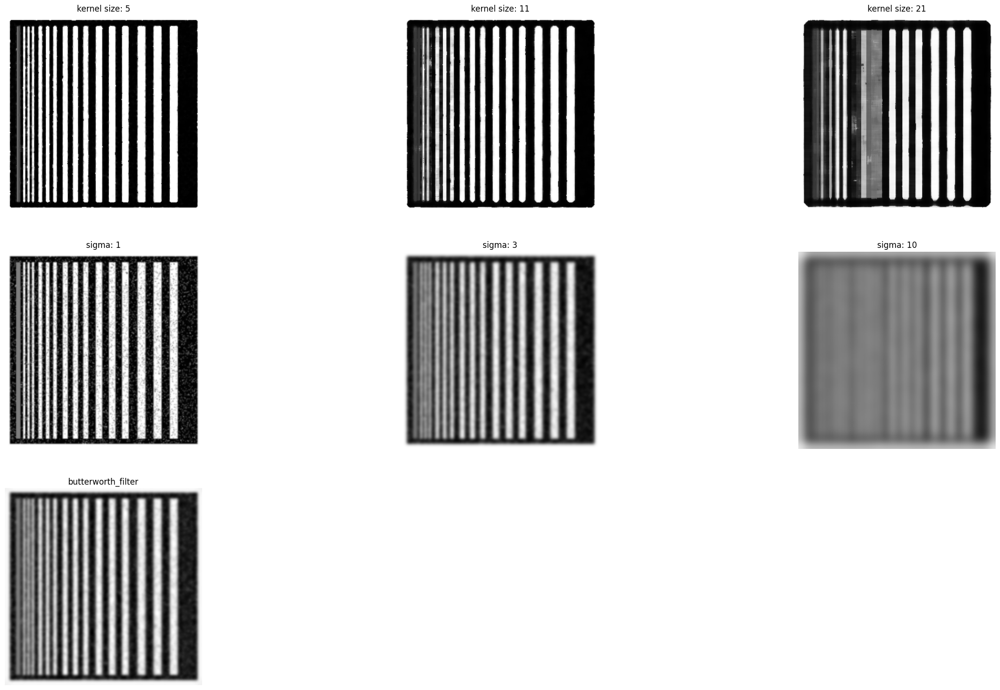

In [182]:
#FILTR MEDIANOWY#
image = cv2.imread("szum.jpg")
plt.figure(figsize=(30, 18))
plt.subplot(3, 3, 1)
plt.axis('off')
plt.imshow(median_filter(image,kernel_sizes[0]),cmap='gray')
plt.title(f'kernel size: 5')
plt.subplot(3, 3, 2)
plt.axis('off')
plt.imshow(median_filter(image,kernel_sizes[1]),cmap='gray')
plt.title(f'kernel size: 11')
plt.subplot(3, 3, 3)
plt.axis('off')
plt.imshow(median_filter(image,kernel_sizes[2]),cmap='gray')
plt.title(f'kernel size: 21')
#FILTR GAUSSOWSKI#
plt.subplot(3, 3, 4)
plt.axis('off')
sigma = 1
plt.imshow(gaussian_filter(image,sigma),cmap='gray')
plt.title(f'sigma: 1')
plt.subplot(3, 3, 5)
plt.axis('off')
sigma = 3
plt.imshow(gaussian_filter(image,sigma),cmap='gray')
plt.title(f'sigma: 3')
plt.subplot(3, 3, 6)
plt.axis('off')
sigma = 10
plt.imshow(gaussian_filter(image,sigma),cmap='gray')
plt.title(f'sigma: 10')
#FILTR BUTTERWORTH#
plt.subplot(3, 3, 7)
plt.axis('off')
plt.imshow(butterworth_filter(image,cutoff_frequency,order),cmap='gray')
plt.title(f'butterworth_filter')

plt.show()

Opisz swoje spostrzeżenia. Czy wszystkie filtry tak samo zachowują krawęzie?  
Filtr Butterwortha to filtrowanie dolnoprzepustowe, co oznacza, że przepuszcza niskie częstotliwości i tłumi wysokie. Wpływ na krawędzie jest zauważalny, zwłaszcza przy użyciu silnych filtrów niskoprzepustowych, co może prowadzić do rozmycia krawędzi.  
  
Filtr Gaussowski, powszechnie stosowany do rozmywania obrazów, ma wpływ na krawędzie zależny od stopnia rozmycia. Silniejsze filtry Gaussowskie, zwłaszcza z dużymi jądrami, mogą prowadzić do rozmazywania krawędzi.  
  
Filtr medianowy, będący filtrem nieliniowym, wykorzystuje medianę zamiast średniej do wygładzania. Jest bardziej efektywny w utrzymaniu krawędzi w porównaniu do filtrów dolnoprzepustowych.

## Zadanie 3 - Wyznaczanie krawędzi

Trzy dowolne obrazy pozyskane w trakcie laboratorium 2 zamień na obrazy monochromatyczne, a następnie wykonaj poniższe polecenia.

### a) Detekcja krawędzi metodą Sobela.
  
Zastosuj filtr Sobela do wybranych obrazów

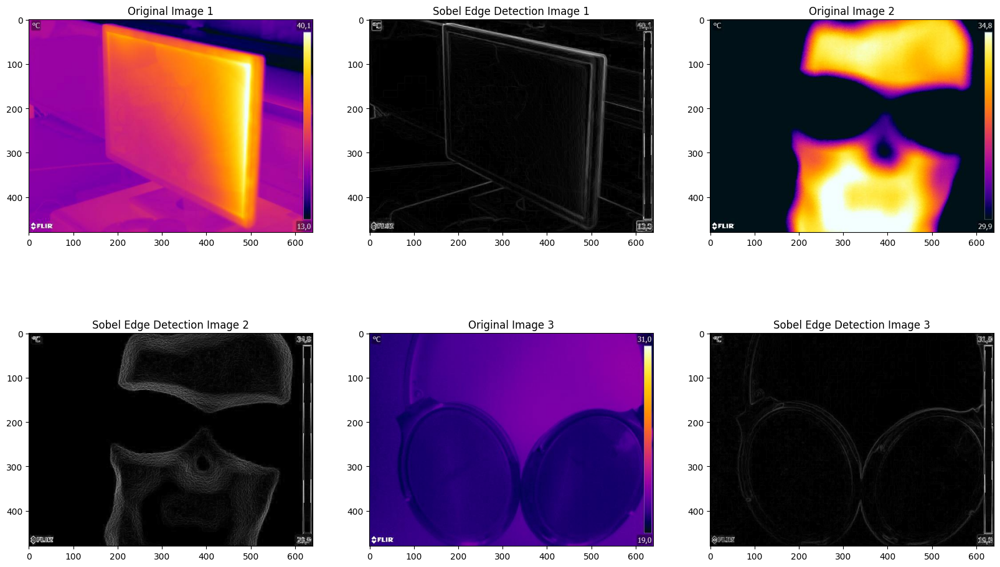

In [201]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def sobel_edge_detection(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sobel_x = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=3)
    magnitude = np.sqrt(sobel_x**2 + sobel_y**2)
    magnitude = np.uint8(magnitude)
    return magnitude

image1 = cv2.imread('42.jpg')
image2 = cv2.imread('26.jpg')
image3 = cv2.imread('5.jpg')

edges_image1 = sobel_edge_detection(image1)
edges_image2 = sobel_edge_detection(image2)
edges_image3 = sobel_edge_detection(image3)

plt.figure(figsize=(20, 12))

plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
plt.title('Original Image 1')

plt.subplot(2, 3, 2)
plt.imshow(edges_image1, cmap='gray')
plt.title('Sobel Edge Detection Image 1')

plt.subplot(2, 3, 3)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.title('Original Image 2')

plt.subplot(2, 3, 4)
plt.imshow(edges_image2, cmap='gray')
plt.title('Sobel Edge Detection Image 2')

plt.subplot(2, 3, 5)
plt.imshow(cv2.cvtColor(image3, cv2.COLOR_BGR2RGB))
plt.title('Original Image 3')

plt.subplot(2, 3, 6)
plt.imshow(edges_image3, cmap='gray')
plt.title('Sobel Edge Detection Image 3')

plt.show()

### b) Detekcja krawędzi metodą Laplace'a.
  
Zastosuj filtr Laplace'a do wybranych obrazów

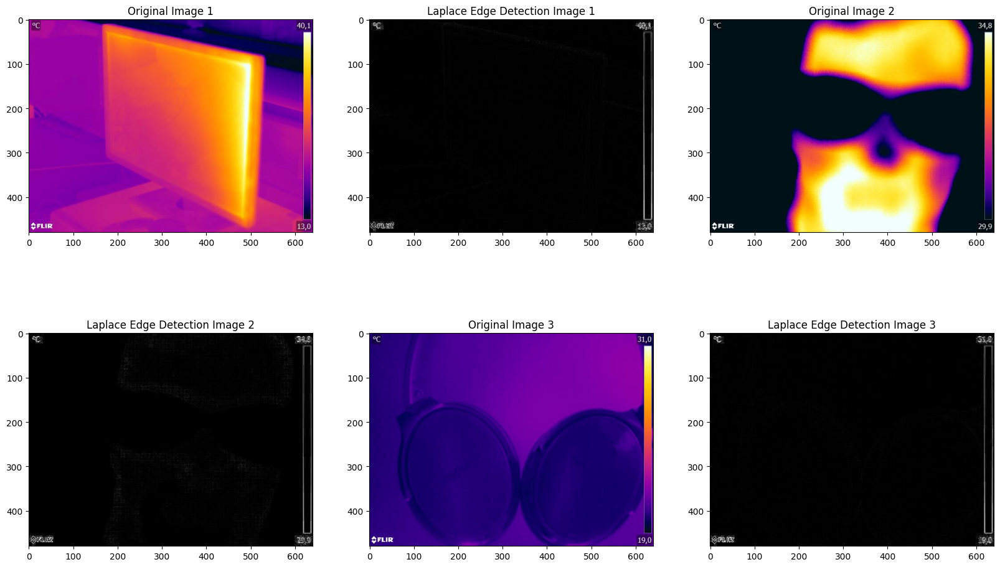

In [203]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def laplace_edge_detection(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    laplacian = cv2.Laplacian(gray_image, cv2.CV_64F)
    laplacian = np.uint8(np.abs(laplacian))
    return laplacian

image1 = cv2.imread('42.jpg')
image2 = cv2.imread('26.jpg')
image3 = cv2.imread('5.jpg')


edges_image1 = laplace_edge_detection(image1)
edges_image2 = laplace_edge_detection(image2)
edges_image3 = laplace_edge_detection(image3)

plt.figure(figsize=(20, 12))

plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
plt.title('Original Image 1')

plt.subplot(2, 3, 2)
plt.imshow(edges_image1, cmap='gray')
plt.title('Laplace Edge Detection Image 1')

plt.subplot(2, 3, 3)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.title('Original Image 2')

plt.subplot(2, 3, 4)
plt.imshow(edges_image2, cmap='gray')
plt.title('Laplace Edge Detection Image 2')

plt.subplot(2, 3, 5)
plt.imshow(cv2.cvtColor(image3, cv2.COLOR_BGR2RGB))
plt.title('Original Image 3')

plt.subplot(2, 3, 6)
plt.imshow(edges_image3, cmap='gray')
plt.title('Laplace Edge Detection Image 3')

plt.show()

### c) Detekcja krawędzi metodą Canny'ego.
  
Zastosuj filtr Canne'ego do wybranych obrazów

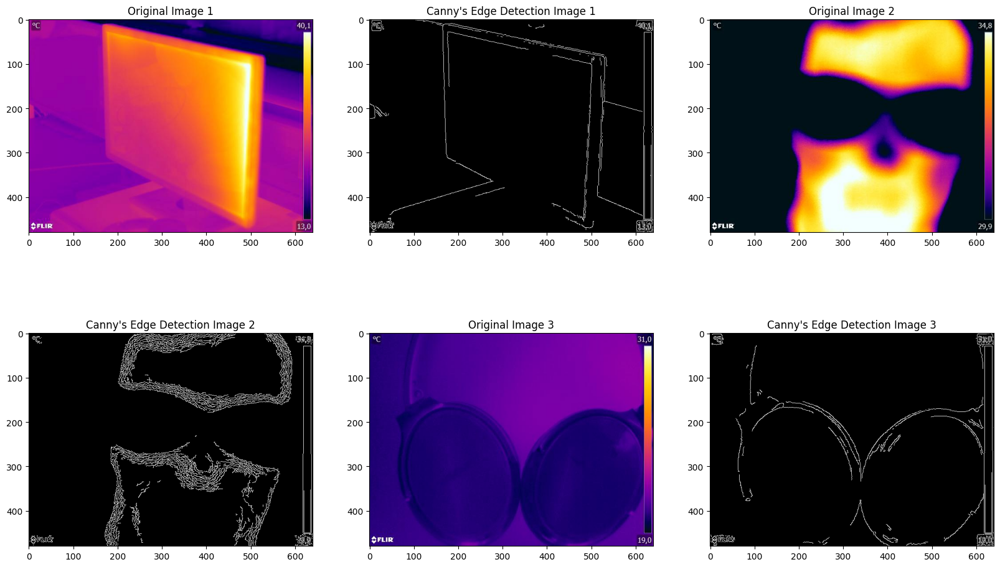

In [205]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def canny_edge_detection(image, low_threshold, high_threshold):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray_image, low_threshold, high_threshold)
    return edges

image1 = cv2.imread('42.jpg')
image2 = cv2.imread('26.jpg')
image3 = cv2.imread('5.jpg')


edges_image1 = canny_edge_detection(image1,30,60)
edges_image2 = canny_edge_detection(image2,30,60)
edges_image3 = canny_edge_detection(image3,20,40)

plt.figure(figsize=(20, 12))

plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
plt.title('Original Image 1')

plt.subplot(2, 3, 2)
plt.imshow(edges_image1, cmap='gray')
plt.title('Canny\'s Edge Detection Image 1')

plt.subplot(2, 3, 3)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.title('Original Image 2')

plt.subplot(2, 3, 4)
plt.imshow(edges_image2, cmap='gray')
plt.title('Canny\'s Edge Detection Image 2')

plt.subplot(2, 3, 5)
plt.imshow(cv2.cvtColor(image3, cv2.COLOR_BGR2RGB))
plt.title('Original Image 3')

plt.subplot(2, 3, 6)
plt.imshow(edges_image3, cmap='gray')
plt.title('Canny\'s Edge Detection Image 3')

plt.show()

Opisz swoje spostrzeżenia po porównaniu 3 metod wyznaczania krawędzi.  
Metoda Sobela jest stosunkowo prosta w zrozumieniu i implementacji, skupiając się na wykrywaniu krawędzi o jednoznacznych kierunkach. Jednakże, może być wrażliwa na szum, co czasem prowadzi do wykrywania fałszywych krawędzi.  

Metoda Laplace'a radzi sobie dobrze z krawędziami o różnych kierunkach i jest mniej wrażliwa na szum w porównaniu do filtra Sobela. Niemniej jednak, ma tendencję do wykrywania podwójnych krawędzi i może zwiększać grubość krawędzi.  

Metoda Canny'ego jest uznawana za efektywną ze względu na zastosowanie filtra Gaussa przed detekcją krawędzi, co pomaga w redukcji szumu. Canny doskonale radzi sobie zarówno z precyzyjną, jak i grubą detekcją krawędzi. Jednakże, jej bardziej zaawansowana implementacja oraz konieczność dobrania odpowiednich parametrów, takich jak próg dolny i próg górny, mogą stanowić wyzwanie.  